# Импорты

In [ ]:
import pandas as pd
import numpy as np

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.cluster import SpectralClustering
from sklearn.cluster import DBSCAN

import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

import seaborn as sns
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# Загрузка датасета

In [ ]:
train = pd.read_csv('https://raw.githubusercontent.com/sebischair/Medical-Abstracts-TC-Corpus/refs/heads/main/medical_tc_train.csv')
test = pd.read_csv('https://raw.githubusercontent.com/sebischair/Medical-Abstracts-TC-Corpus/refs/heads/main/medical_tc_test.csv')
labels = pd.read_csv('https://raw.githubusercontent.com/sebischair/Medical-Abstracts-TC-Corpus/refs/heads/main/medical_tc_labels.csv')

In [ ]:
train.sample(3)

,condition_label,medical_abstract
10423,5,Surgical aspects of malaria. The spread of dru...
64,5,Early and frequent detection of HBxAg and/or a...
10228,5,Surgical complications with the cochlear multi...


In [ ]:
test.sample(3)

,condition_label,medical_abstract
377,4,Ablation of the atrioventricular junction with...
140,4,Retrograde recanalization of an occluded poste...
529,2,Pleuropulmonary manifestations of hepatic ameb...


In [ ]:
labels

,condition_label,condition_name
0,1,neoplasms
1,2,digestive system diseases
2,3,nervous system diseases
3,4,cardiovascular diseases
4,5,general pathological conditions


In [ ]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('punkt_tab')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'] + 'one two study three may usings used result case group without'.split(' '))
stop_words.update({'patient', 'treatment'})
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


In [ ]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [ ]:
train['medical_abstract'] = train.apply(lambda i: preprocess(i.medical_abstract), axis=1)
test['medical_abstract']  = test.apply(lambda i: preprocess(i.medical_abstract), axis=1)

In [ ]:
data = pd.concat([train, test], axis=0)
data.shape

(14438, 2)

# Инструменты

## Визуализации

In [ ]:
def get_workcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    joint_texts = ' '.join(list(texts))
    return wordcloud.generate(joint_texts)

In [ ]:
def draw_clouds_by_clusters(texts_by_clusters, clouds_shape):
    fig, axes = plt.subplots(clouds_shape[0], clouds_shape[1], figsize=(16, 6))

    plt.title(f"Облака слов для {clouds_shape[0]*clouds_shape[1]} кластеров")
    clusters_count = texts_by_clusters['cluster'].nunique()

    for i in range(clouds_shape[0]):
        for j in range(clouds_shape[1]):
            if clouds_shape[0] > 1:
                ax = axes[i, j]
            elif clouds_shape[0] == 1:
                ax = axes[j]
            ax.axis('off')

            cluster_index = i*clouds_shape[1] + j
            if cluster_index >=  clusters_count:
                ax.set_title(f'', fontsize=12, fontweight='bold', pad=20)
                continue

            wordcloud = get_workcloud(texts_by_clusters[texts_by_clusters['cluster'] == cluster_index]['text'])

            ax.imshow(wordcloud, interpolation='bilinear')
            ax.set_title(f'Облако для типа {cluster_index}',
                                fontsize=12, fontweight='bold', pad=20)
    plt.show()
    plt.tight_layout()

In [ ]:
def draw_clusterization_on_plane(data_coords_2d, labels, n_clusters):
    data_to_plot = data_coords_2d.assign(cluster = lambda df : labels)
    scatter = sns.scatterplot(data=data_to_plot, x='x', y='y', hue='cluster', alpha=0.7, palette='bright')

    plt.axis('off')
    plt.title(f"Разбиение текстов на {n_clusters} типов (проекция на плоскость)")
    plt.tight_layout()

## Кластеризации

In [ ]:
def get_texts_by_clusters_kmeans(data, X, clusters_count):
    kmeans_model = KMeans(n_clusters=clusters_count, random_state=42, init='k-means++')
    clusters = kmeans_model.fit_predict(X)

    texts_by_clusters = pd.DataFrame({
        "text" : data.medical_abstract,
        "cluster" : clusters
    })

    return texts_by_clusters

In [ ]:
def get_texts_by_clusters_spectral(data, X, clusters_count):
    spectral_model = SpectralClustering(n_clusters=clusters_count, random_state=42)
    clusters = spectral_model.fit_predict(X)

    texts_by_clusters = pd.DataFrame({
        "text" : data.medical_abstract,
        "cluster" : clusters
    })

    return texts_by_clusters

In [ ]:
def get_texts_by_clusters_dbscan(data, X, clusters_count):
    pass

# Эксперименты

## Векторизация TF-IDF

In [ ]:
vectorizer = TfidfVectorizer(min_df=0.01)
X_tfidf    = vectorizer.fit_transform(data.medical_abstract)
data_tfidf = pd.DataFrame(X_tfidf.toarray(), columns=vectorizer.get_feature_names_out())

In [ ]:
tsne = TSNE(n_components=2)

data_tfidf_tsne = tsne.fit_transform(data_tfidf)
data_tfidf_tsne = (pd.DataFrame(data_tfidf_tsne)
                    .rename(columns = {0 : 'x', 1 : 'y'}))

### Кластеризация по разметке

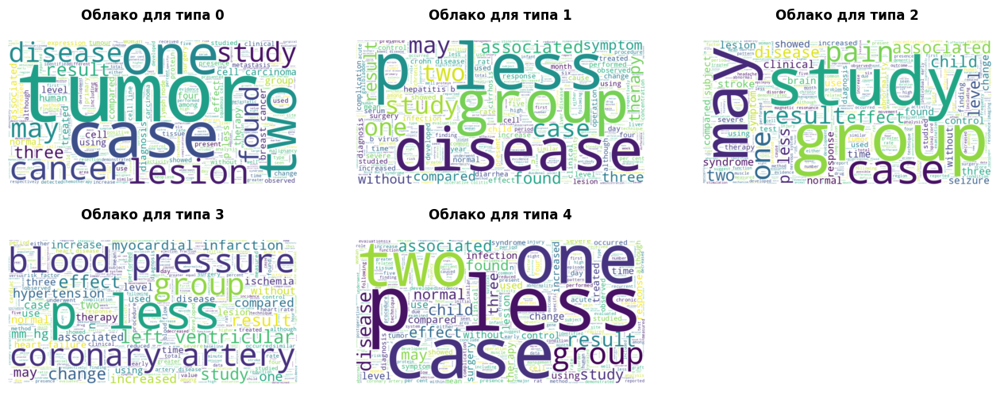

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(
    data.rename(columns={'medical_abstract' : 'text', 'condition_label' : 'cluster'}).assign(cluster = lambda df : data['condition_label'] - 1),
    (2, 3))

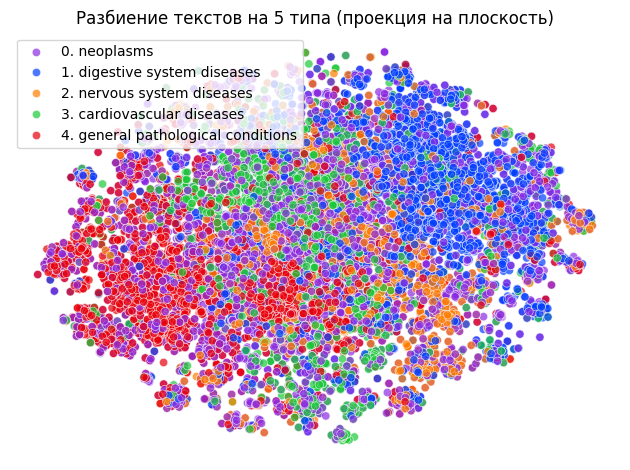

In [ ]:
draw_clusterization_on_plane(data_tfidf_tsne, data.reset_index()['condition_label'], 5)
plt.legend(labels=labels.apply(lambda row : str(row['condition_label'] - 1) + '. ' + row['condition_name'], axis=1))

### Кластеризация `kmeans`

In [ ]:
texts_by_clusters_2 = get_texts_by_clusters_kmeans(data, X_tfidf, 2)

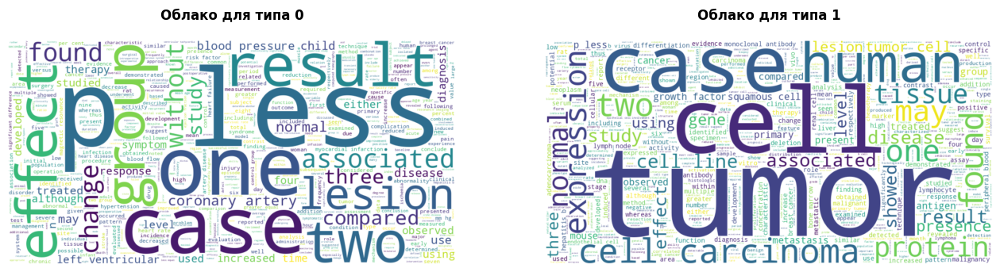

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_2, (1, 2))

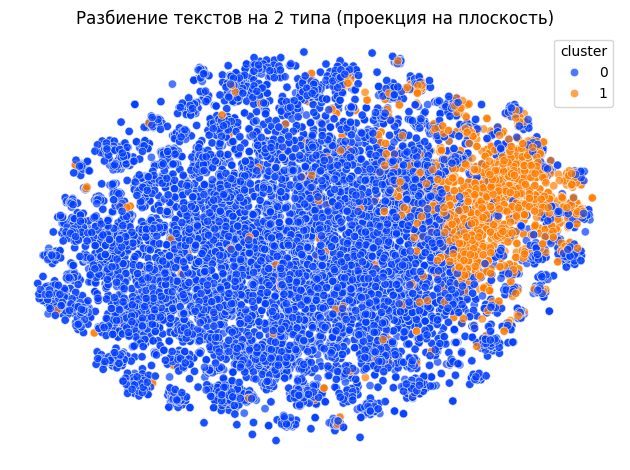

In [ ]:
draw_clusterization_on_plane(data_tfidf_tsne, texts_by_clusters_2.reset_index()['cluster'], 2)

In [ ]:
texts_by_clusters_4 = get_texts_by_clusters_kmeans(data, X_tfidf, 4)

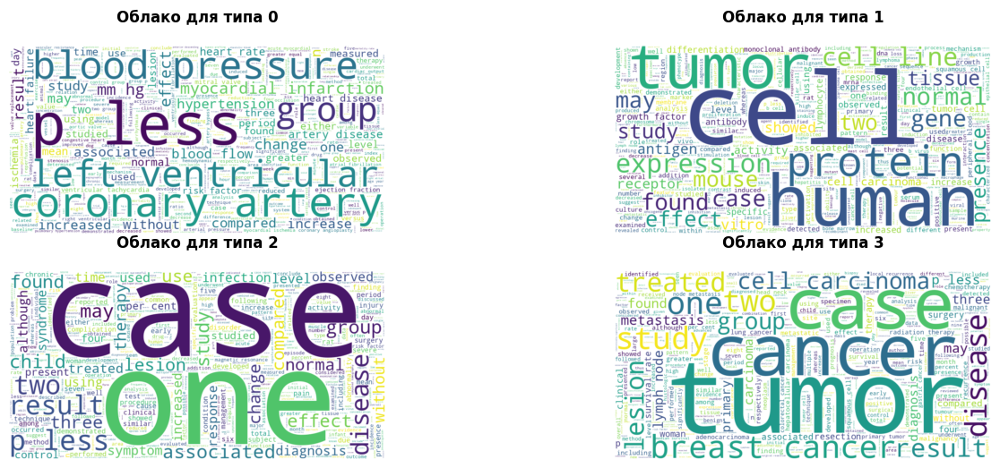

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_4, (2, 2))

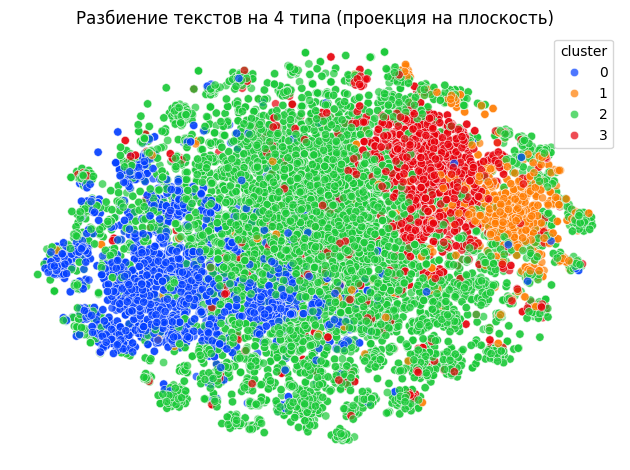

In [ ]:
draw_clusterization_on_plane(data_tfidf_tsne, texts_by_clusters_4.reset_index()['cluster'], 4)

In [ ]:
texts_by_clusters_8 = get_texts_by_clusters_kmeans(data, X_tfidf, 8)

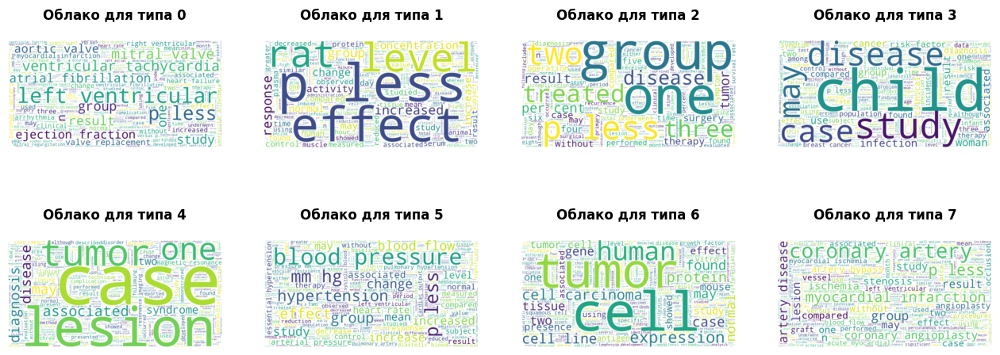

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_8, (2, 4))

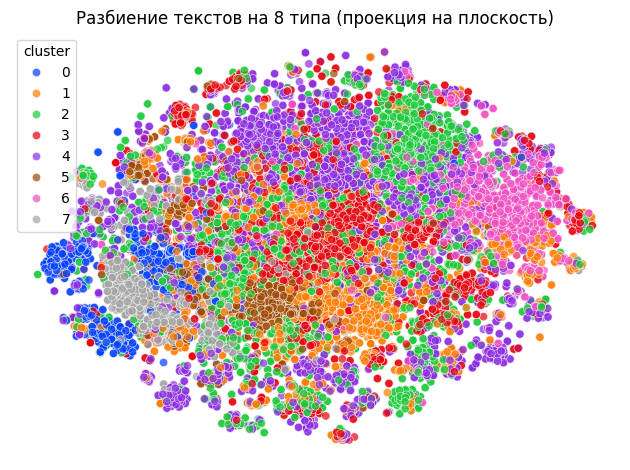

In [ ]:
draw_clusterization_on_plane(data_tfidf_tsne, texts_by_clusters_8.reset_index()['cluster'], 8)

In [ ]:
texts_by_clusters_10 = get_texts_by_clusters_kmeans(data, X_tfidf, 10)

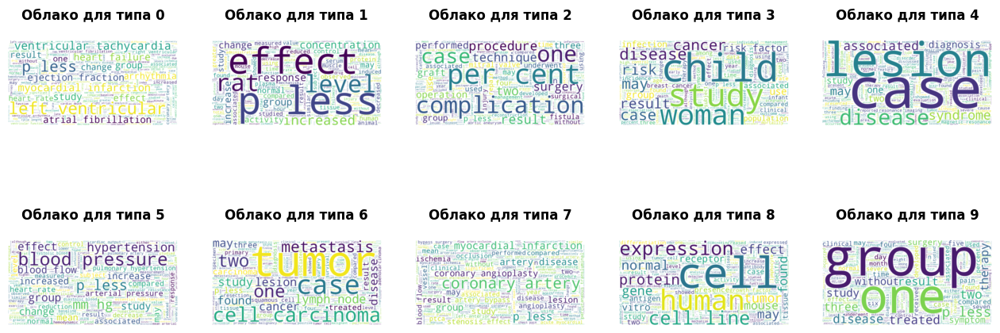

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_10, (2, 5))

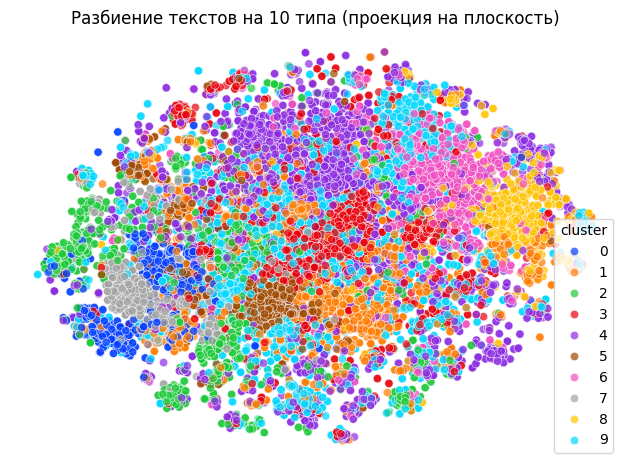

In [ ]:
draw_clusterization_on_plane(data_tfidf_tsne, texts_by_clusters_10.reset_index()['cluster'], 10)

### Кластеризация `spectral`

In [ ]:
texts_by_clusters_2 = get_texts_by_clusters_spectral(data, X_tfidf, 2)

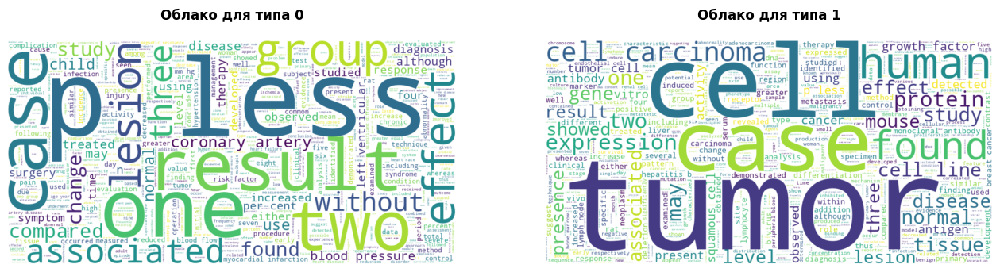

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_2, (1, 2))

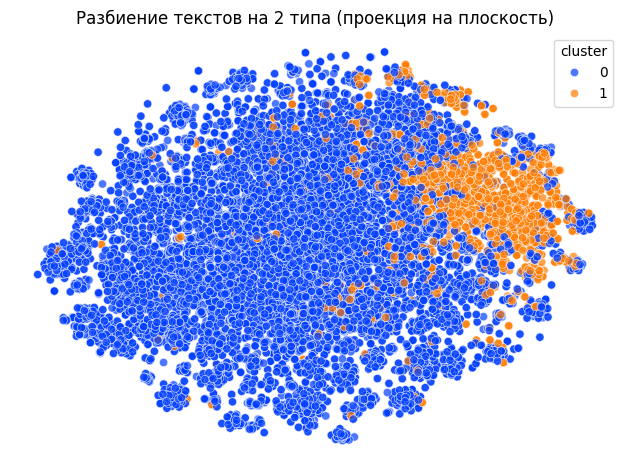

In [ ]:
draw_clusterization_on_plane(data_tfidf_tsne, texts_by_clusters_2.reset_index()['cluster'], 2)

In [ ]:
texts_by_clusters_4 = get_texts_by_clusters_spectral(data, X_tfidf, 4)

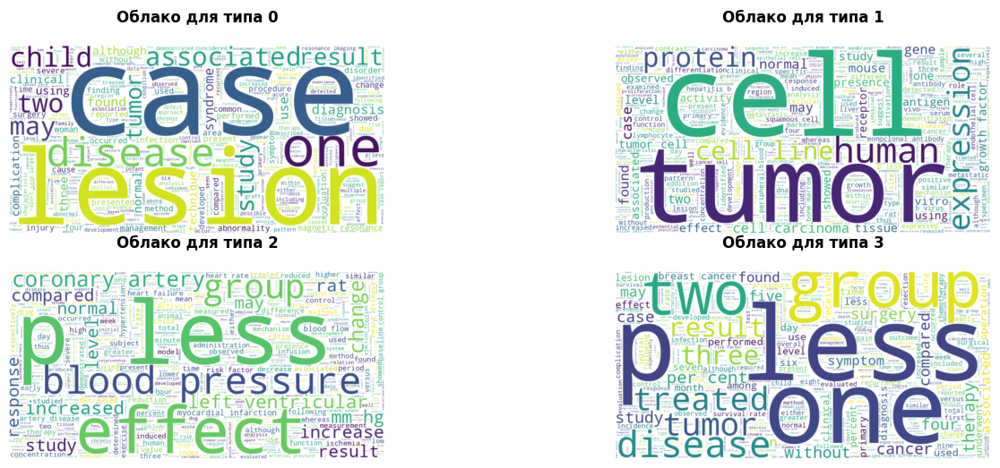

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_4, (2, 2))

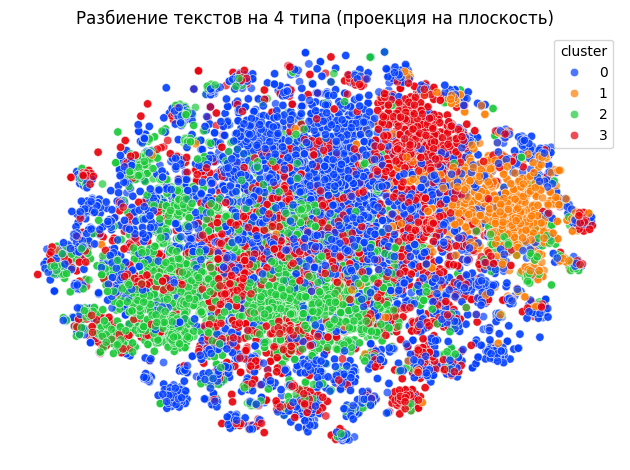

In [ ]:
draw_clusterization_on_plane(data_tfidf_tsne, texts_by_clusters_4.reset_index()['cluster'], 4)

In [ ]:
texts_by_clusters_8 = get_texts_by_clusters_spectral(data, X_tfidf, 8)

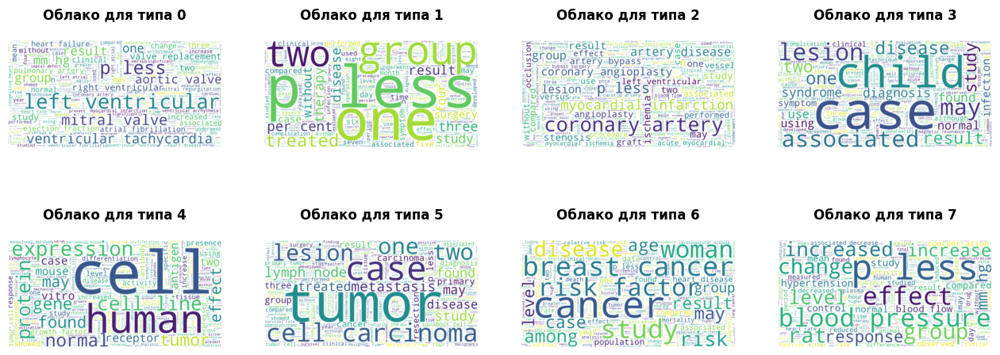

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_8, (2, 4))

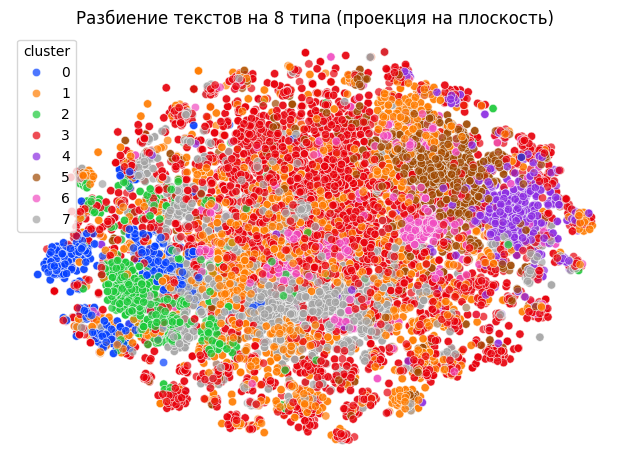

In [ ]:
draw_clusterization_on_plane(data_tfidf_tsne, texts_by_clusters_8.reset_index()['cluster'], 8)

In [ ]:
texts_by_clusters_10 = get_texts_by_clusters_spectral(data, X_tfidf, 10)

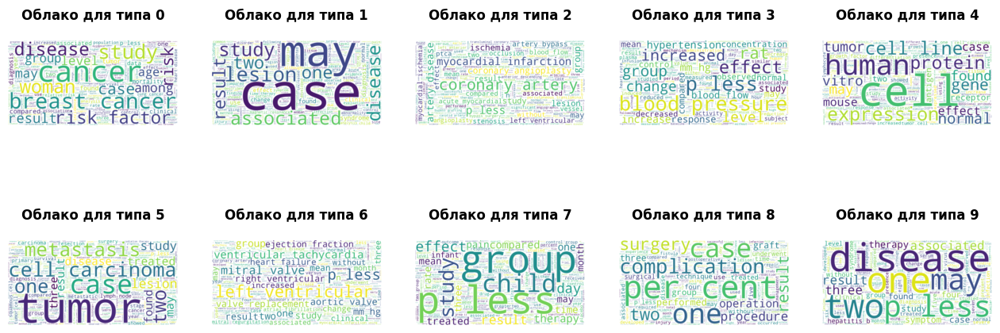

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_10, (2, 5))

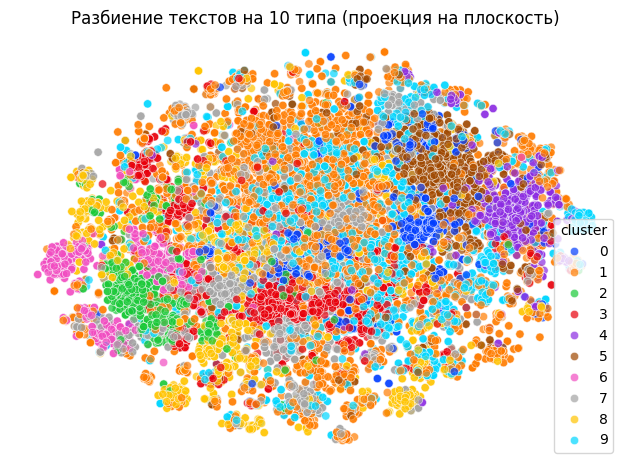

In [ ]:
draw_clusterization_on_plane(data_tfidf_tsne, texts_by_clusters_10.reset_index()['cluster'], 10)

## Векторизация Word2Vec

In [ ]:
!pip install gensim

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.9/27.9 MB 50.4 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
from gensim.models import Word2Vec
from nltk.tokenize import word_tokenize
import nltk

# Токенизация текста

def get_word2vec_vectorized(texts):
    tokenized_data = texts.apply(lambda x: word_tokenize(x.lower()))

    model = Word2Vec(
        sentences=tokenized_data,
        vector_size=100,      # размерность векторов
        window=5,            # размер окна контекста
        min_count=1,         # минимальная частота слова
        workers=4,           # количество потоков
        epochs=10           # количество эпох
    )

    # Функция для получения вектора документа (среднее векторов слов)
    def get_doc_vector(text_tokens, model):
        vectors = []
        for word in text_tokens:
            if word in model.wv:
                vectors.append(model.wv[word])
        if vectors:
            return np.mean(vectors, axis=0)
        else:
            return np.zeros(model.vector_size)

    doc_vectors = tokenized_data.apply(lambda x: get_doc_vector(x, model))

    return pd.DataFrame(doc_vectors.tolist())

X_word2vec = get_word2vec_vectorized(data.medical_abstract)

In [ ]:
tsne = TSNE(n_components=2)

data_word2vec_tsne = tsne.fit_transform(X_word2vec)
data_word2vec_tsne = (pd.DataFrame(data_word2vec_tsne)
                    .rename(columns = {0 : 'x', 1 : 'y'}))

### Кластеризация по разметке

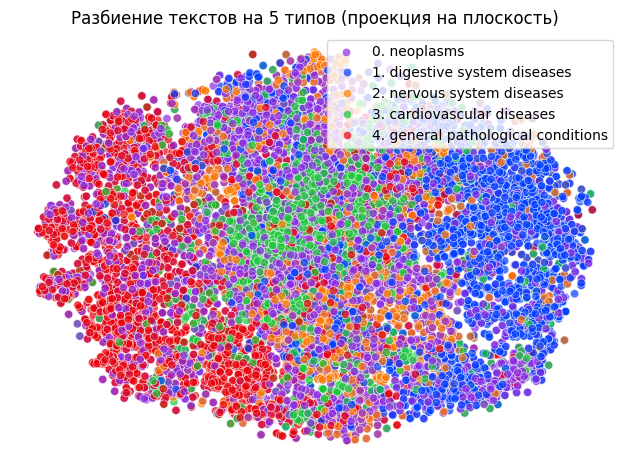

In [ ]:
draw_clusterization_on_plane(data_word2vec_tsne, data.reset_index()['condition_label'], 5)
plt.legend(labels=labels.apply(lambda row : str(row['condition_label'] - 1) + '. ' + row['condition_name'], axis=1))

### Кластеризация `kmeans`

In [ ]:
texts_by_clusters_2 = get_texts_by_clusters_kmeans(data, X_word2vec, 2)

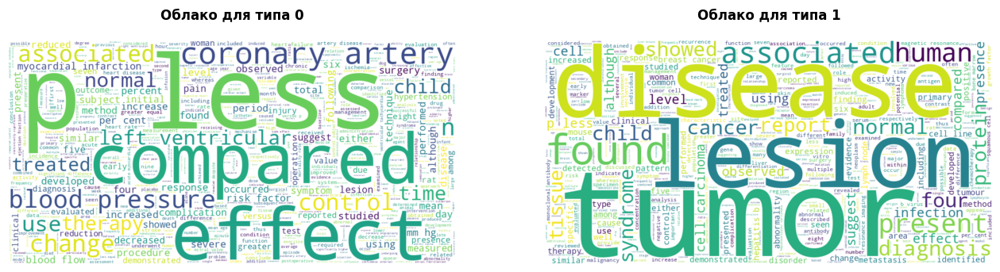

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_2, (1, 2))

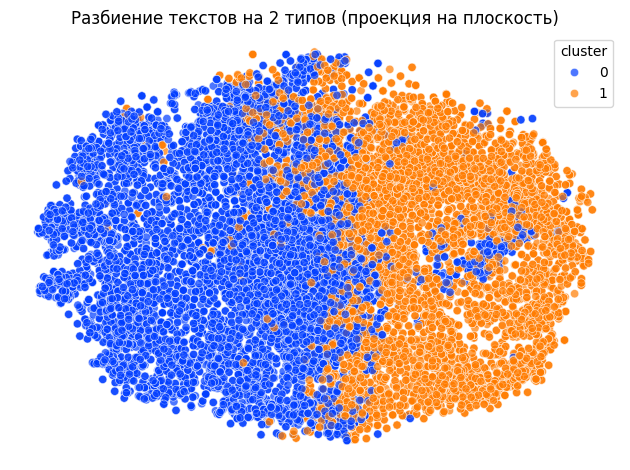

In [ ]:
draw_clusterization_on_plane(data_word2vec_tsne, texts_by_clusters_2.reset_index()['cluster'], 2)

In [ ]:
texts_by_clusters_4 = get_texts_by_clusters_kmeans(data, X_word2vec, 4)

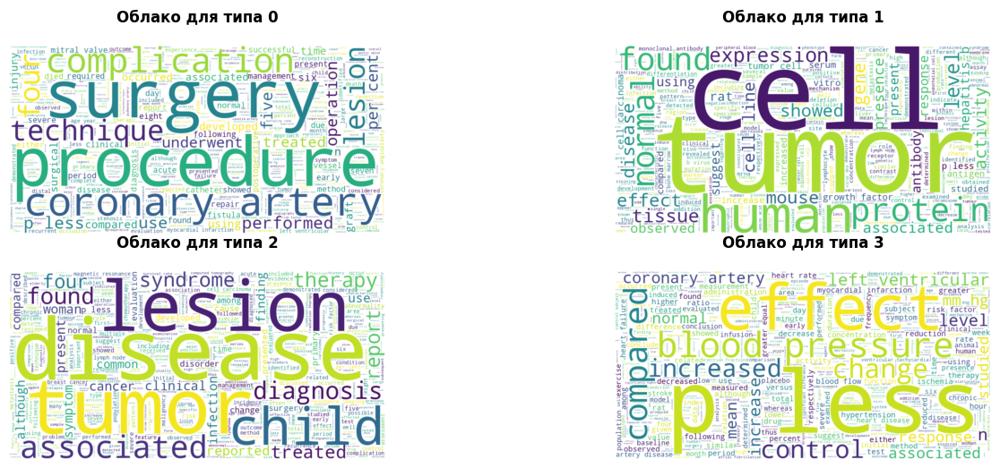

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_4, (2, 2))

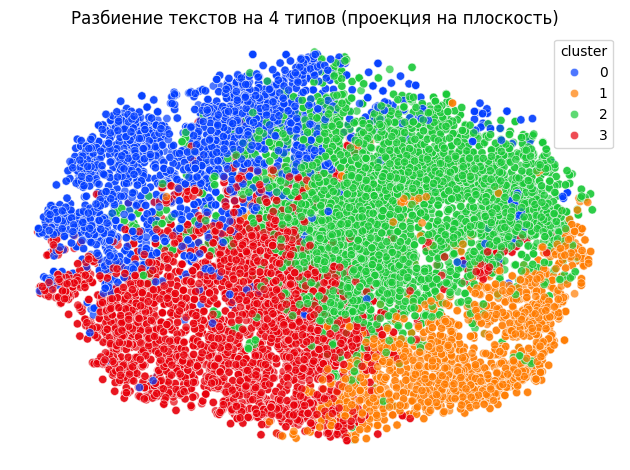

In [ ]:
draw_clusterization_on_plane(data_word2vec_tsne, texts_by_clusters_4.reset_index()['cluster'], 4)

In [ ]:
texts_by_clusters_8 = get_texts_by_clusters_kmeans(data, X_word2vec, 8)

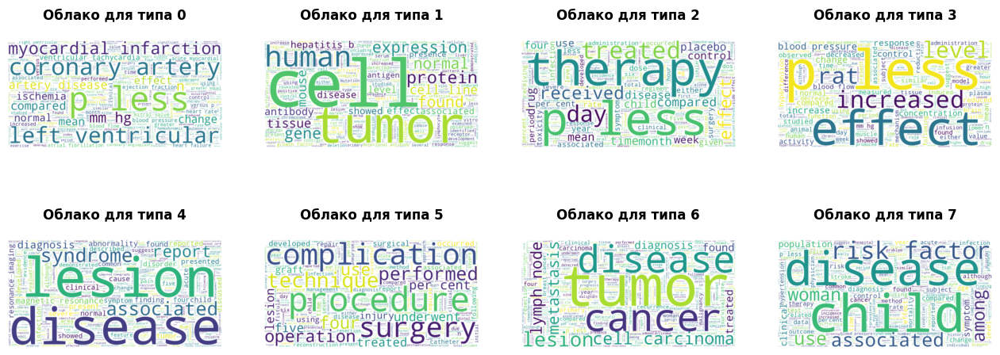

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_8, (2, 4))

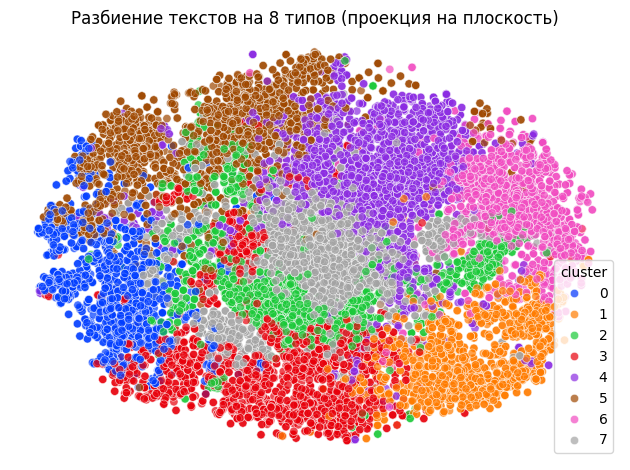

In [ ]:
draw_clusterization_on_plane(data_word2vec_tsne, texts_by_clusters_8.reset_index()['cluster'], 8)

In [ ]:
texts_by_clusters_10 = get_texts_by_clusters_kmeans(data, X_word2vec, 10)

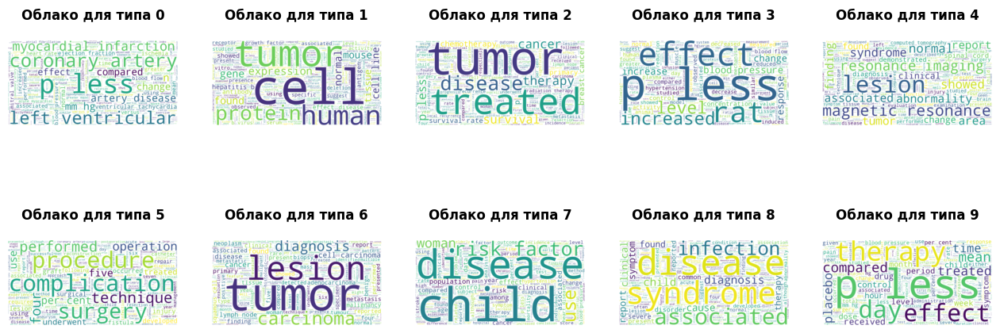

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_10, (2, 5))

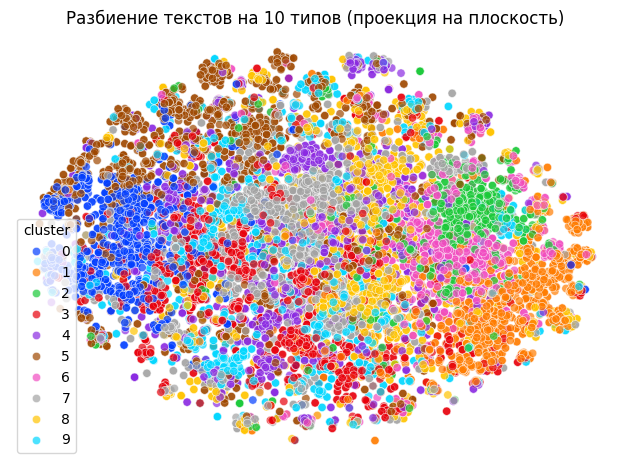

In [ ]:
draw_clusterization_on_plane(data_tfidf_tsne, texts_by_clusters_10.reset_index()['cluster'], 10)

## Векторизация FastText

In [ ]:
!pip install fasttext

In [ ]:
!wget https://dl.fbaipublicfiles.com/fasttext/vectors-crawl/cc.en.300.bin.gz

--2026-01-29 13:25:49--  https://dl.fbaipublicfiles.com/fasttext/vectors-crawl/cc.en.300.bin.gz
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 3.167.112.51, 3.167.112.53, 3.167.112.66, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|3.167.112.51|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4503593528 (4.2G) [application/octet-stream]
Saving to: ‘cc.en.300.bin.gz’

cc.en.300.bin.gz    100%[===================>]   4.19G   147MB/s    in 38s     

2026-01-29 13:26:27 (113 MB/s) - ‘cc.en.300.bin.gz’ saved [4503593528/4503593528]



In [ ]:
!gzip -d cc.en.300.bin.gz

gzip: cc.en.300.bin already exists; do you wish to overwrite (y or n)? n
	not overwritten


In [ ]:
import fasttext
import fasttext.util

ft = fasttext.load_model('cc.en.300.bin')

def vectorize_series(series, model):
    vectors = []
    for text in series:
        vector = model.get_sentence_vector(text)
        vectors.append(vector)
    return np.array(vectors)

X_fasttext = vectorize_series(data.medical_abstract, ft)

In [ ]:
tsne = TSNE(n_components=2)

data_fasttext_tsne = tsne.fit_transform(X_fasttext)
data_fasttext_tsne = (pd.DataFrame(data_fasttext_tsne)
                    .rename(columns = {0 : 'x', 1 : 'y'}))

### Кластеризация по разметке

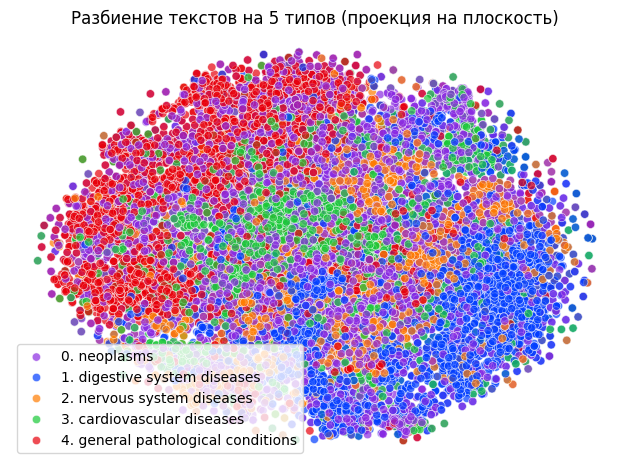

In [ ]:
draw_clusterization_on_plane(data_fasttext_tsne, data.reset_index()['condition_label'], 5)
plt.legend(labels=labels.apply(lambda row : str(row['condition_label'] - 1) + '. ' + row['condition_name'], axis=1))

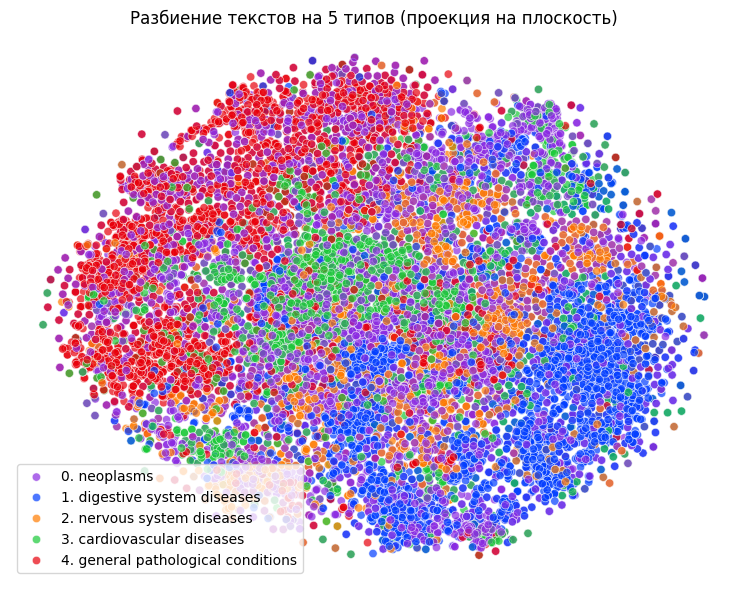

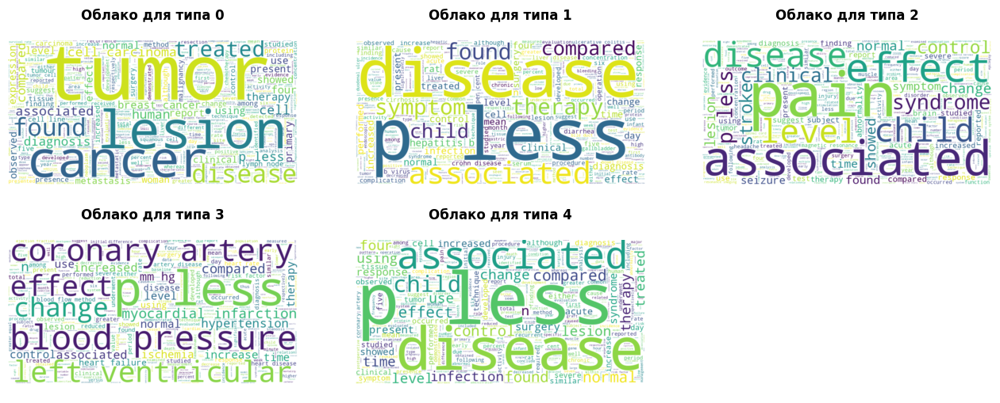

<Figure size 640x480 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 6))

plt.subplot(1, 2, 1)  # 1 строка, 2 столбца, позиция 1
draw_clusterization_on_plane(data_fasttext_tsne, data.reset_index()['condition_label'], 5)
plt.legend(labels=labels.apply(lambda row : str(row['condition_label'] - 1) + '. ' + row['condition_name'], axis=1))

plt.subplot(1, 2, 1)  # 1 строка, 2 столбца, позиция 2
draw_clouds_by_clusters(
    data.rename(columns={'medical_abstract' : 'text', 'condition_label' : 'cluster'}).assign(cluster = lambda df : data['condition_label'] - 1),
    (2, 3))
plt.tight_layout()
plt.show()

### Кластеризация `kmeans`

In [ ]:
texts_by_clusters_2 = get_texts_by_clusters_kmeans(data, X_fasttext, 2)

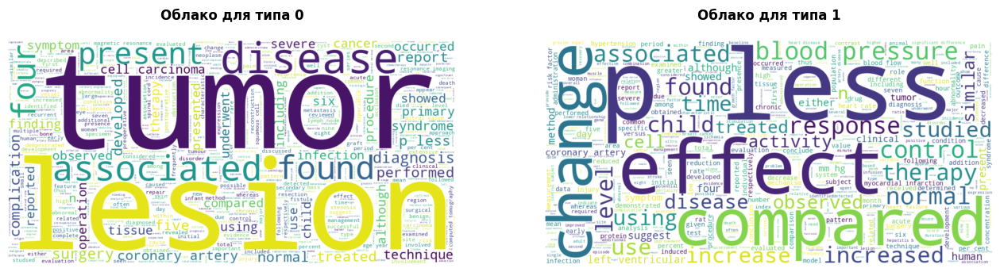

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_2, (1, 2))

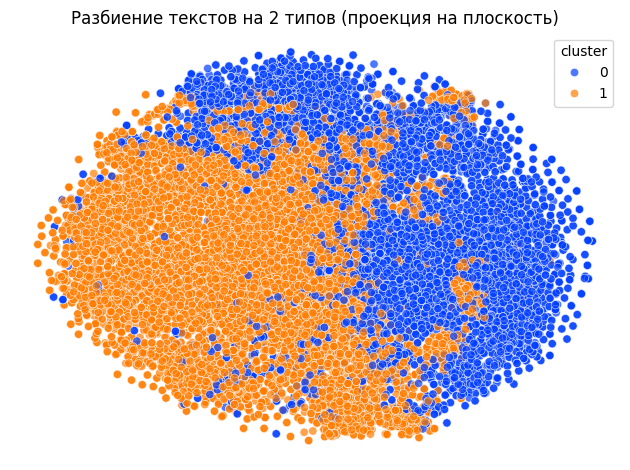

In [ ]:
draw_clusterization_on_plane(data_fasttext_tsne, texts_by_clusters_2.reset_index()['cluster'], 2)

In [ ]:
texts_by_clusters_4 = get_texts_by_clusters_kmeans(data, X_fasttext, 4)

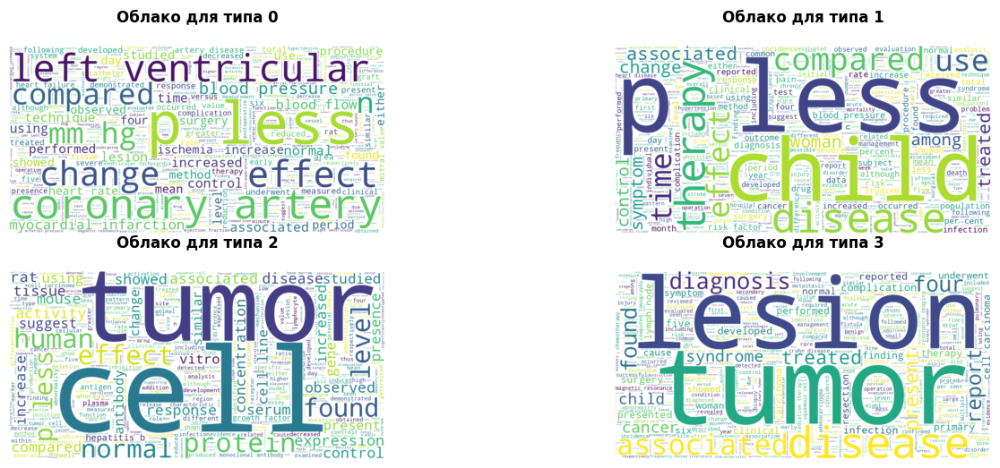

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_4, (2, 2))

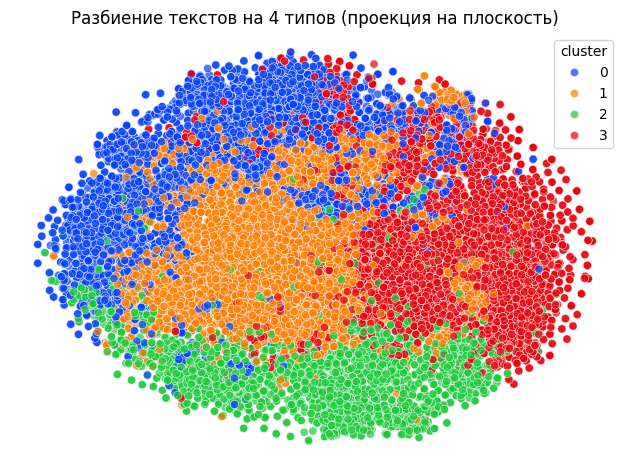

In [ ]:
draw_clusterization_on_plane(data_fasttext_tsne, texts_by_clusters_4.reset_index()['cluster'], 4)

In [ ]:
texts_by_clusters_8 = get_texts_by_clusters_kmeans(data, X_fasttext, 8)

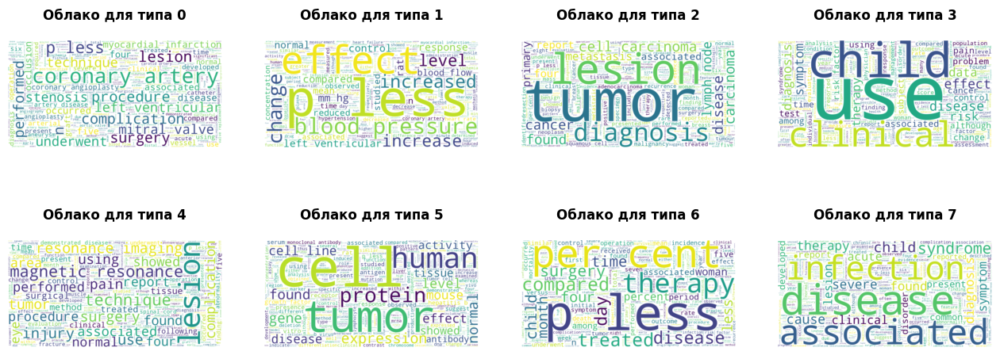

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_8, (2, 4))

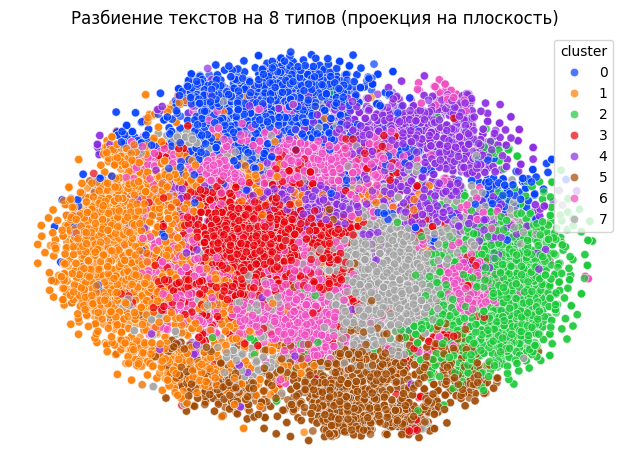

In [ ]:
draw_clusterization_on_plane(data_fasttext_tsne, texts_by_clusters_8.reset_index()['cluster'], 8)

In [ ]:
texts_by_clusters_10 = get_texts_by_clusters_kmeans(data, X_fasttext, 10)

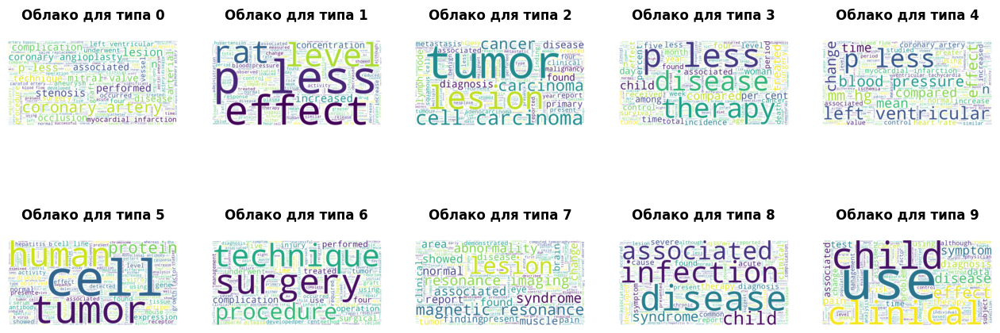

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_10, (2, 5))

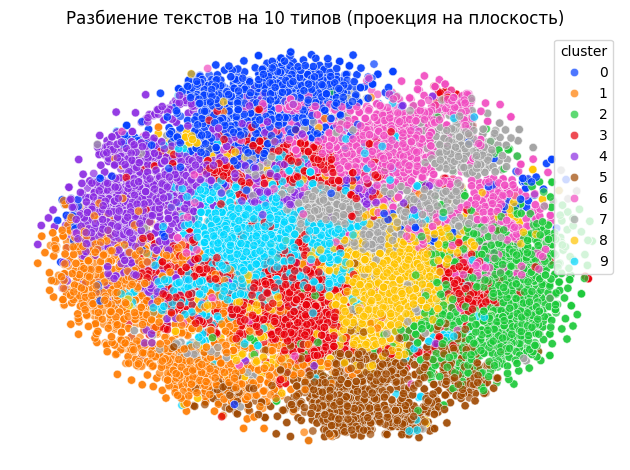

In [ ]:
draw_clusterization_on_plane(data_fasttext_tsne, texts_by_clusters_10.reset_index()['cluster'], 10)

## Векторизация Doc2Vec

In [ ]:
import pandas as pd
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from gensim.utils import simple_preprocess

def get_doc2vec_vectorized(texts):
    def prepare_documents(series):
        documents = []
        for i, text in enumerate(series):
            tokens = simple_preprocess(text)  # токенизация
            documents.append(TaggedDocument(tokens, [i]))
        return documents

    tagged_docs = prepare_documents(texts)
    model = Doc2Vec(
        vector_size=100,  # размерность вектора
        window=5,
        min_count=1,
        workers=4,
        epochs=20
    )

    model.build_vocab(tagged_docs)
    model.train(tagged_docs, total_examples=model.corpus_count, epochs=model.epochs)

    def vectorize_series(series, model):
        vectors = []
        for text in series:
            tokens = simple_preprocess(text)
            vector = model.infer_vector(tokens)
            vectors.append(vector)
        return np.array(vectors)

    return vectorize_series(texts, model)
X_doc2vec = get_doc2vec_vectorized(data.medical_abstract)

In [ ]:
X_doc2vec.shape

(14438, 100)

In [ ]:
tsne = TSNE(n_components=2)

data_doc2vec_tsne = tsne.fit_transform(X_doc2vec)
data_doc2vec_tsne = (pd.DataFrame(data_doc2vec_tsne)
                    .rename(columns = {0 : 'x', 1 : 'y'}))

### Кластеризация по разметке

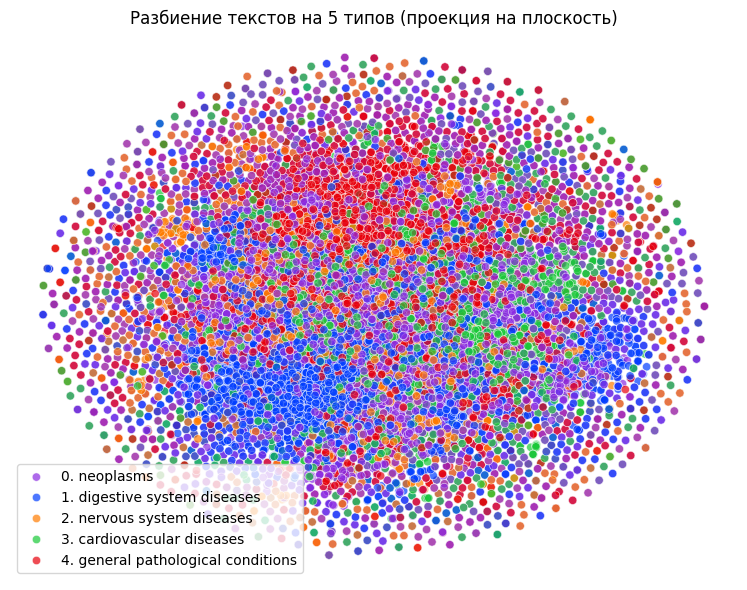

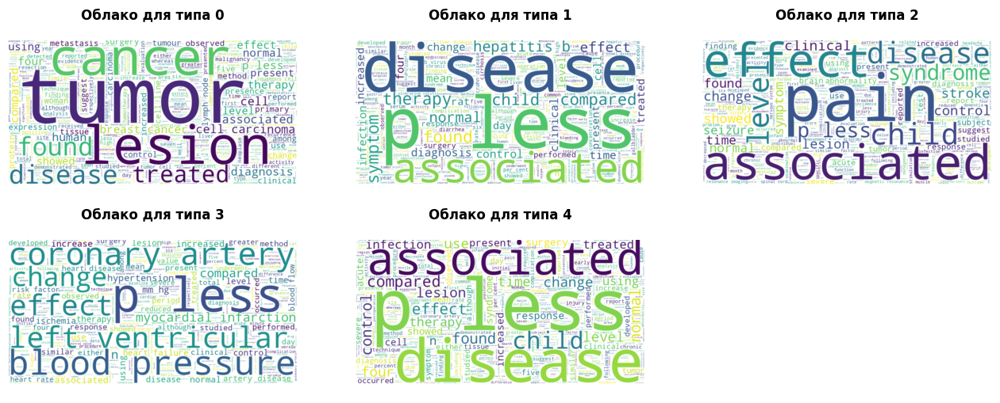

<Figure size 640x480 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 6))

plt.subplot(1, 2, 1)  # 1 строка, 2 столбца, позиция 1
draw_clusterization_on_plane(data_doc2vec_tsne, data.reset_index()['condition_label'], 5)
plt.legend(labels=labels.apply(lambda row : str(row['condition_label'] - 1) + '. ' + row['condition_name'], axis=1))

plt.subplot(1, 2, 1)  # 1 строка, 2 столбца, позиция 2
draw_clouds_by_clusters(
    data.rename(columns={'medical_abstract' : 'text', 'condition_label' : 'cluster'}).assign(cluster = lambda df : data['condition_label'] - 1),
    (2, 3))
plt.tight_layout()
plt.show()

### Кластеризация `kmeans`

In [ ]:
texts_by_clusters_2 = get_texts_by_clusters_kmeans(data, X_doc2vec, 2)

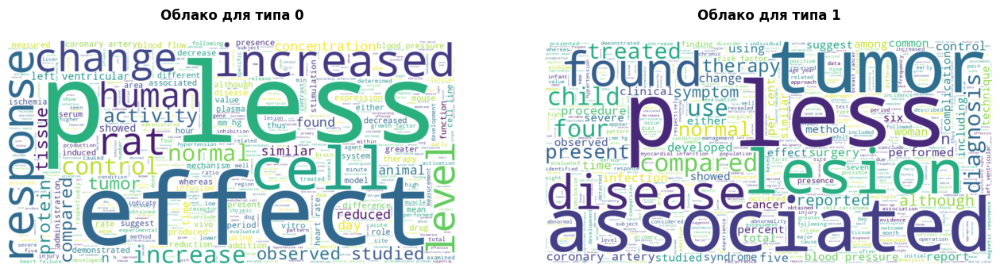

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_2, (1, 2))

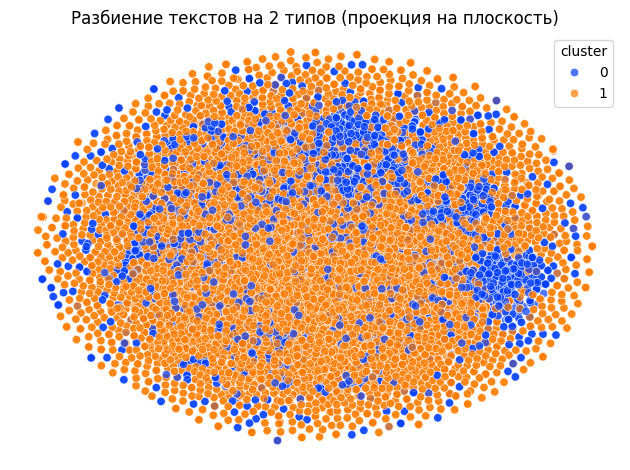

In [ ]:
draw_clusterization_on_plane(data_doc2vec_tsne, texts_by_clusters_2.reset_index()['cluster'], 2)

In [ ]:
texts_by_clusters_4 = get_texts_by_clusters_kmeans(data, X_doc2vec, 4)

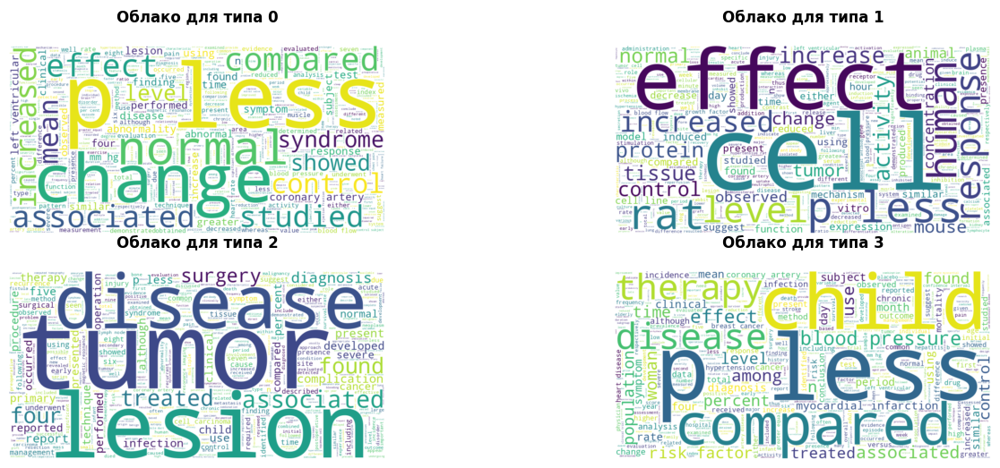

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_4, (2, 2))

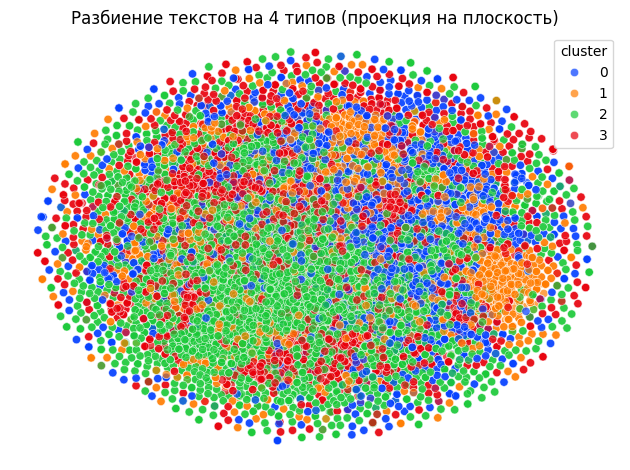

In [ ]:
draw_clusterization_on_plane(data_doc2vec_tsne, texts_by_clusters_4.reset_index()['cluster'], 4)

In [ ]:
texts_by_clusters_8 = get_texts_by_clusters_kmeans(data, X_doc2vec, 8)

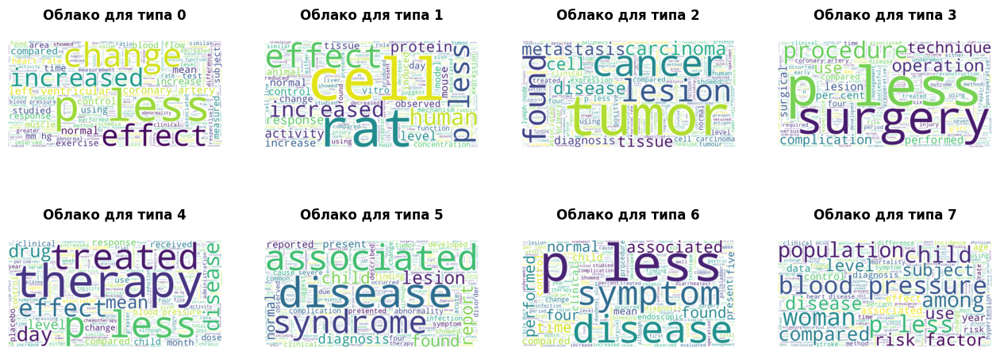

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_8, (2, 4))

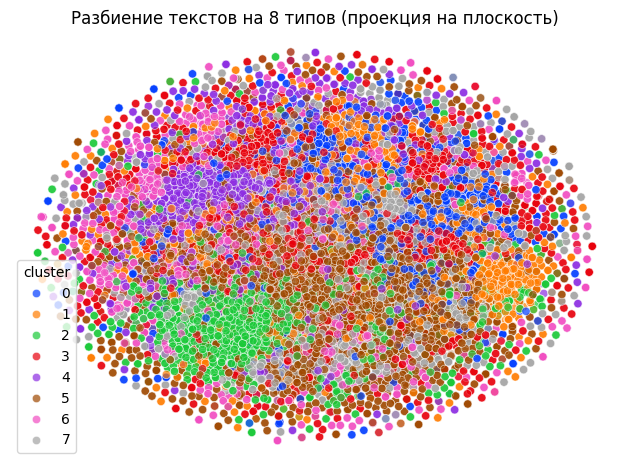

In [ ]:
draw_clusterization_on_plane(data_doc2vec_tsne, texts_by_clusters_8.reset_index()['cluster'], 8)

In [ ]:
texts_by_clusters_10 = get_texts_by_clusters_kmeans(data, X_doc2vec, 10)

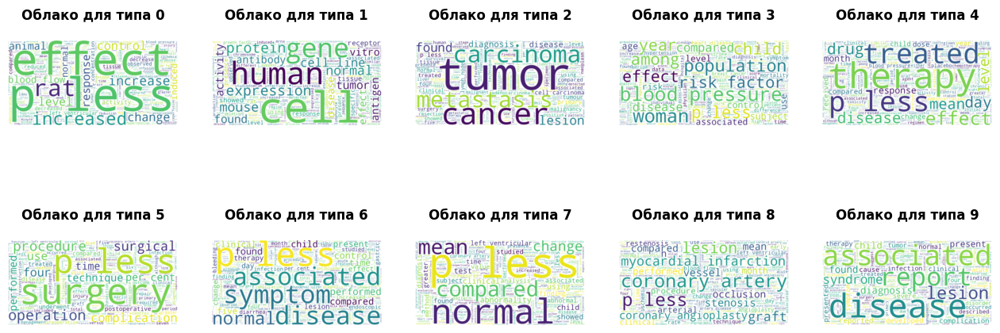

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_10, (2, 5))

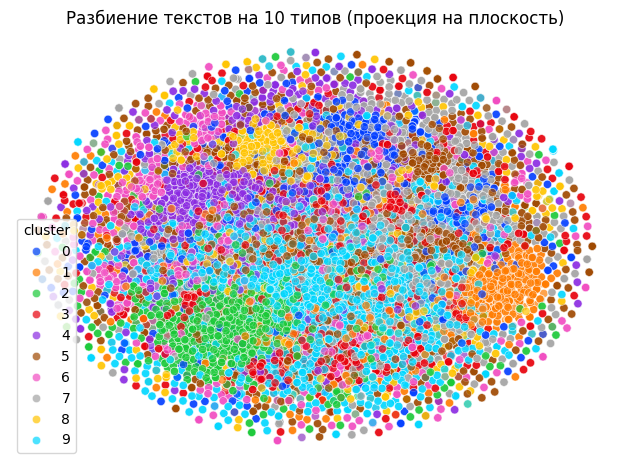

In [ ]:
draw_clusterization_on_plane(data_doc2vec_tsne, texts_by_clusters_10.reset_index()['cluster'], 10)

## Векторизация BERT

In [ ]:
import torch
from transformers import AutoTokenizer, AutoModel
from tqdm import tqdm

# Загрузка ClinicalBERT
model_name = "emilyalsentzer/Bio_ClinicalBERT"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModel.from_pretrained(model_name)

def vectorize_text(text, max_length=128):
    """Векторизация одного текста"""
    inputs = tokenizer(
        text,
        return_tensors='pt',
        max_length=max_length,
        truncation=True,
        padding='max_length'
    )

    with torch.no_grad():
        outputs = model(**inputs)

    # Используем среднее pooling скрытых состояний последнего слоя
    embeddings = outputs.last_hidden_state.mean(dim=1)
    return embeddings.squeeze().numpy()

# Векторизация всего Series
def vectorize_series(text_series, max_length=32):
    vectors = []
    for text in tqdm(text_series):
        vector = vectorize_text(str(text), max_length)
        vectors.append(vector)
    return np.array(vectors)

# Пример использования
df = pd.DataFrame({'text_column': ['Patient presents with fever', 'CT scan shows pneumonia', ...]})
X_clinicalbert = vectorize_series(data.medical_abstract)

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/436M [00:00<?, ?B/s]

  0%|          | 4/14438 [00:00<45:20,  5.31it/s]

model.safetensors:   0%|          | 0.00/436M [00:00<?, ?B/s]

100%|██████████| 14438/14438 [43:16<00:00,  5.56it/s]


In [ ]:
X_clinicalbert

array([[ 0.1051856 , -0.19286889, -0.3221914 , ...,  0.04173791,
        -0.09813806, -0.17515688],
       [ 0.32027167, -0.04769022, -0.34785146, ...,  0.181761  ,
        -0.102851  , -0.16470155],
       [-0.06934597,  0.15947455, -0.31211966, ...,  0.13394645,
        -0.12993194, -0.15867049],
       ...,
       [ 0.31669605,  0.00701809, -0.10660133, ...,  0.13056917,
         0.07025574,  0.00178389],
       [ 0.10258456,  0.10918115, -0.15518421, ..., -0.04754957,
         0.05950259, -0.34310937],
       [ 0.05137966, -0.06080353, -0.24143991, ...,  0.08035965,
        -0.07395292, -0.0463553 ]], dtype=float32)

In [ ]:
tsne = TSNE(n_components=2)

data_clinicalbert_tsne = tsne.fit_transform(X_clinicalbert)
data_clinicalbert_tsne = (pd.DataFrame(data_clinicalbert_tsne)
                    .rename(columns = {0 : 'x', 1 : 'y'}))

### Кластеризация по разметке

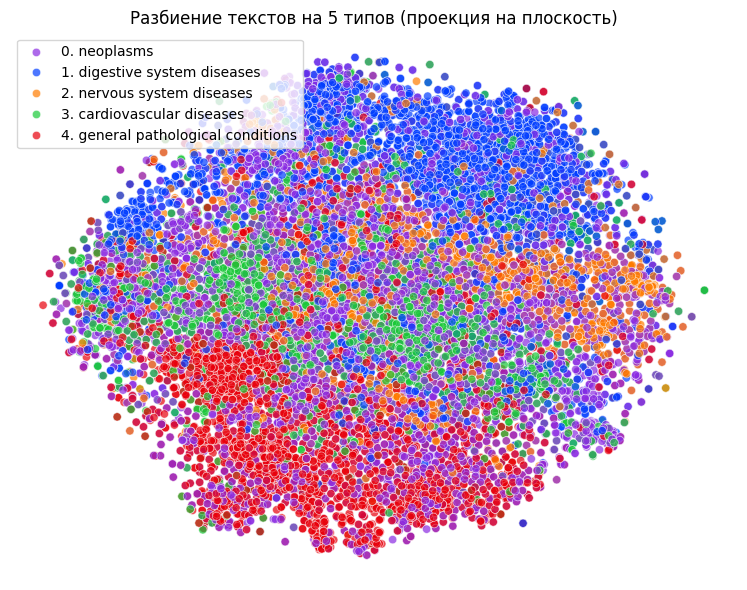

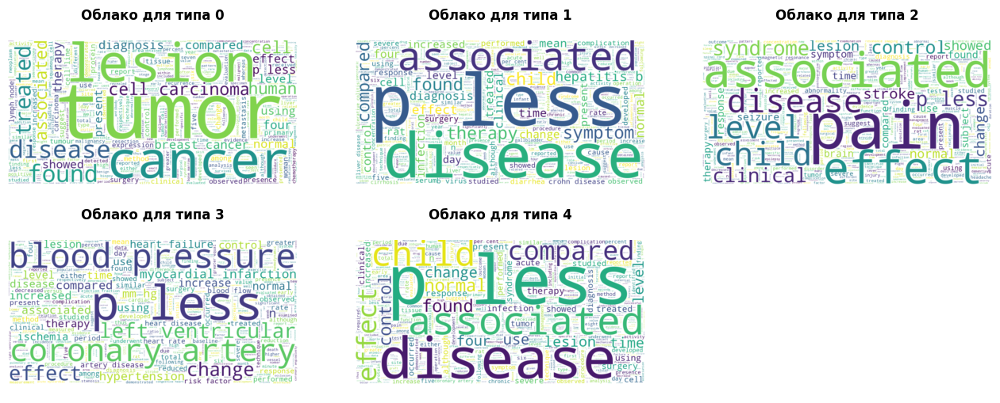

<Figure size 640x480 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 6))

plt.subplot(1, 2, 1)  # 1 строка, 2 столбца, позиция 1
draw_clusterization_on_plane(data_clinicalbert_tsne, data.reset_index()['condition_label'], 5)
plt.legend(labels=labels.apply(lambda row : str(row['condition_label'] - 1) + '. ' + row['condition_name'], axis=1))

plt.subplot(1, 2, 1)  # 1 строка, 2 столбца, позиция 2
draw_clouds_by_clusters(
    data.rename(columns={'medical_abstract' : 'text', 'condition_label' : 'cluster'}).assign(cluster = lambda df : data['condition_label'] - 1),
    (2, 3))
plt.tight_layout()
plt.show()

### Кластеризация `kmeans`

In [ ]:
texts_by_clusters_2 = get_texts_by_clusters_kmeans(data, X_clinicalbert, 2)

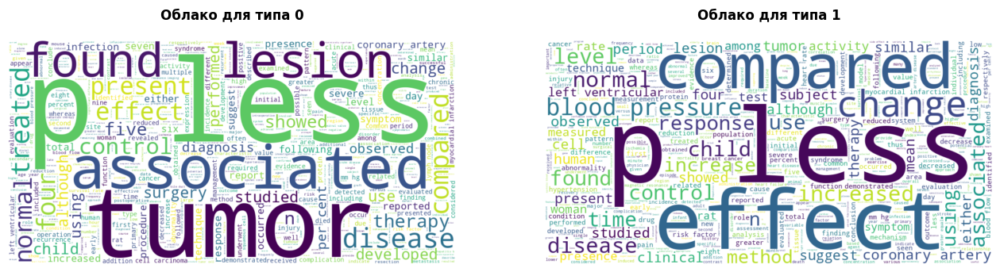

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_2, (1, 2))

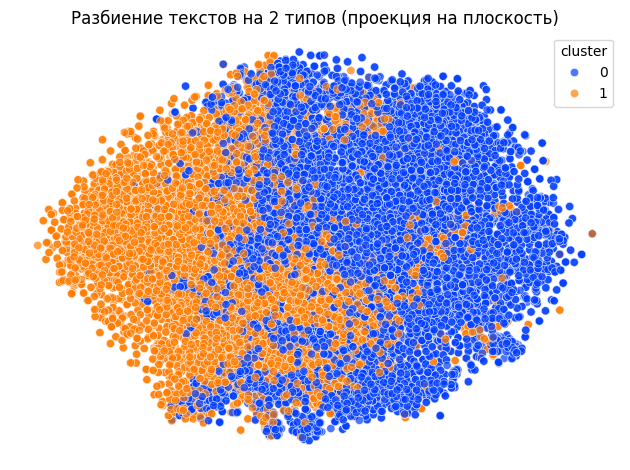

In [ ]:
draw_clusterization_on_plane(data_clinicalbert_tsne, texts_by_clusters_2.reset_index()['cluster'], 2)

In [ ]:
texts_by_clusters_4 = get_texts_by_clusters_kmeans(data, X_clinicalbert, 4)

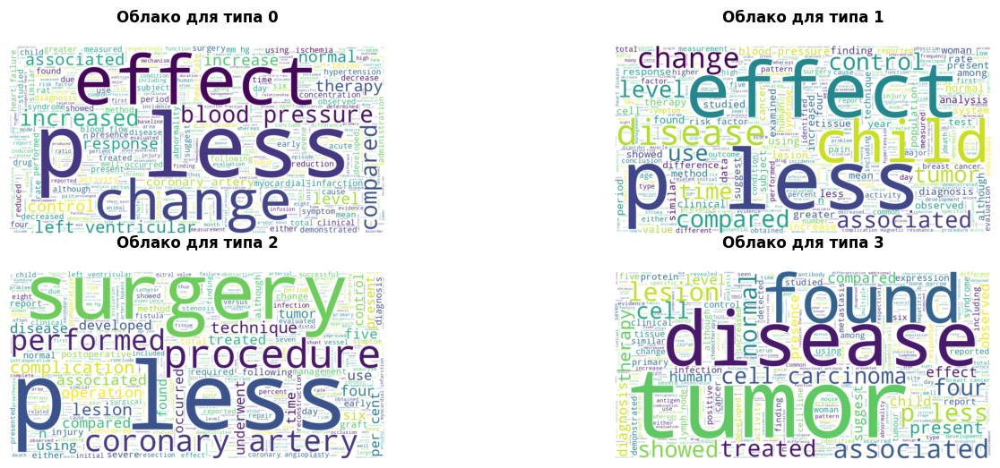

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_4, (2, 2))

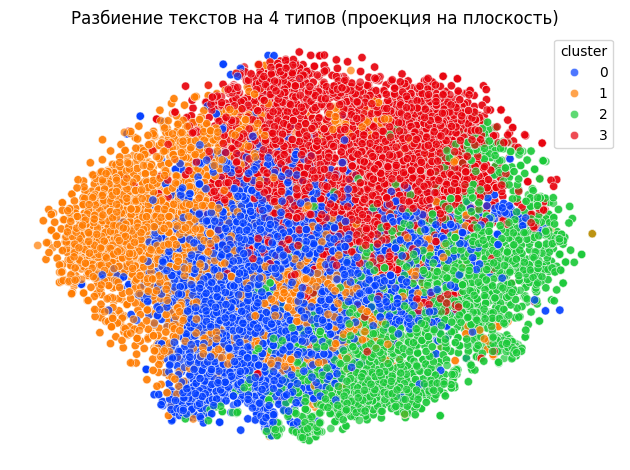

In [ ]:
draw_clusterization_on_plane(data_clinicalbert_tsne, texts_by_clusters_4.reset_index()['cluster'], 4)

In [ ]:
texts_by_clusters_8 = get_texts_by_clusters_kmeans(data, X_clinicalbert, 8)

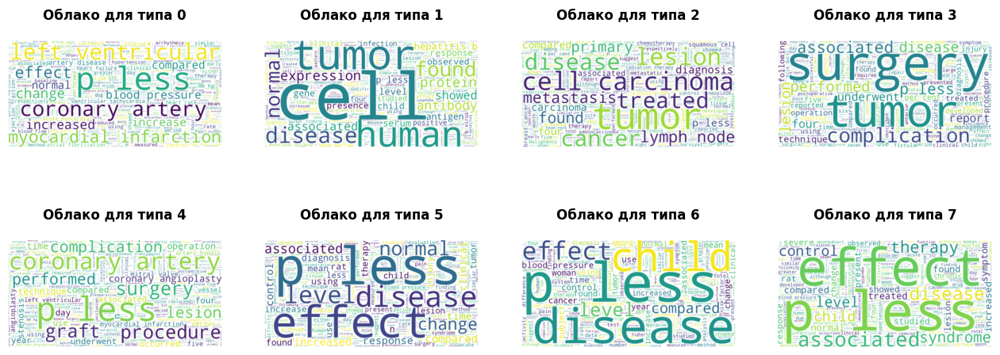

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_8, (2, 4))

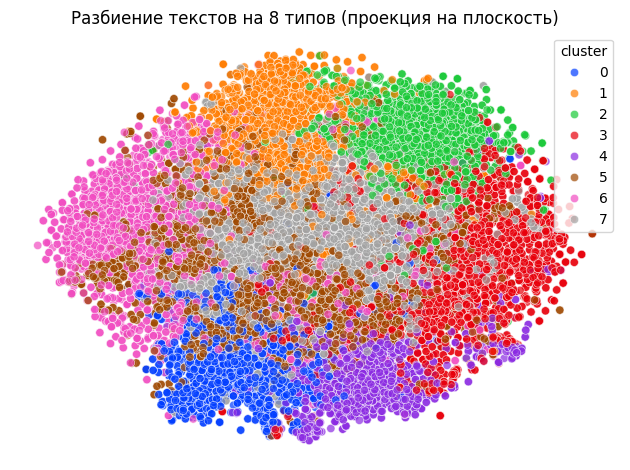

In [ ]:
draw_clusterization_on_plane(data_clinicalbert_tsne, texts_by_clusters_8.reset_index()['cluster'], 8)

In [ ]:
texts_by_clusters_10 = get_texts_by_clusters_kmeans(data, X_clinicalbert, 10)

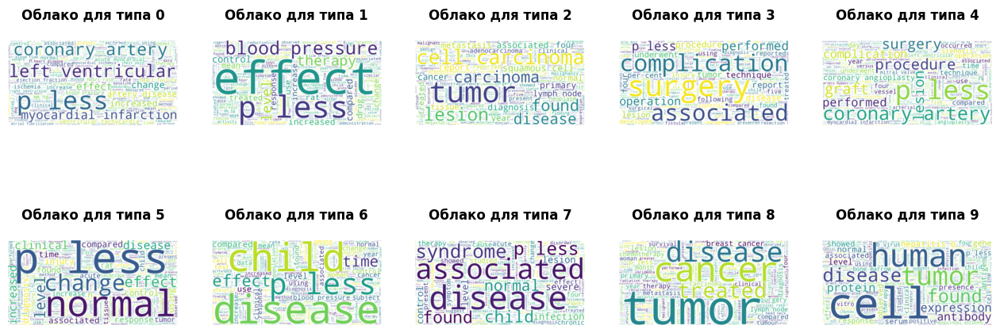

<Figure size 640x480 with 0 Axes>

In [ ]:
draw_clouds_by_clusters(texts_by_clusters_10, (2, 5))

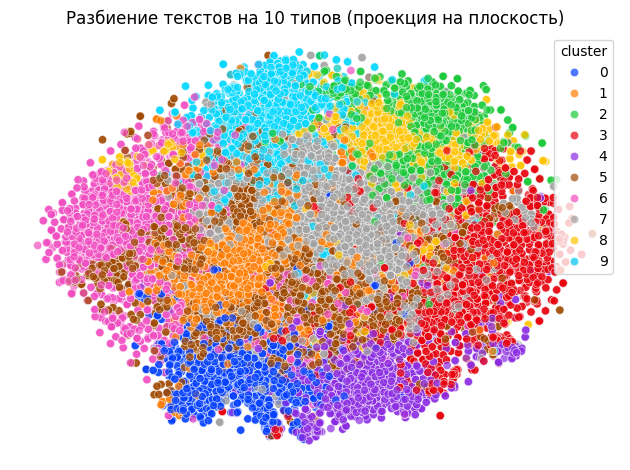

In [ ]:
draw_clusterization_on_plane(data_clinicalbert_tsne, texts_by_clusters_10.reset_index()['cluster'], 10)